# Odczyt i normalizacja danych emg.

In [172]:
import sys

sys.path.append("..")

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.pyplot import subplot
from matplotlib.pyplot import figure
from IPython.display import set_matplotlib_formats

set_matplotlib_formats("svg")
mpl.rcParams["axes.spines.right"] = False
mpl.rcParams["axes.spines.top"] = False
plt.style.use("seaborn-ticks")
%matplotlib inline
from pyomeca import Analogs

from ezc3d import c3d

In [189]:
data_path = "../Jupyter/c3d/B0437 PrzenoszeniePrawidlowe T01.c3d"
data_path2 = "../Jupyter/c3d/B0437 PrzenoszeniePrawidlowe T02.c3d"
data_path3 = "../Jupyter/c3d/B0437 PrzenoszenieNieprawidlowe T02.c3d"

#### Wczytanie danych analogowych i przydzielenie odpowiednich nazw

In [174]:
def read_analogs(data_path):
    muscles = [
    "Voltage.1",
    "Voltage.2",
    "Voltage.3",
    "Voltage.4",
    "Voltage.5",
    "Voltage.6",
    "Voltage.7",
    "Voltage.8",
    "Voltage.9",
    "Voltage.10",
    "Voltage.11",
    "Voltage.12",
    "Voltage.13",
    "Voltage.14",
    "Voltage.15",
    "Voltage.16"]
    
    emg = Analogs.from_c3d(data_path, usecols=muscles)
    
    muscles_names = [
    "Czworoboczny grzbietu L",
    "Trójgłowy ramienia L", 
    "Dwugłowy ramienia L", 
    "Prostownik nadgarstka L",
    "Skośny brzucha L", 
    "Pośladkowy średni L",
    "Czworogłowy uda L", 
    "Brzuchaty łydki L",
    "Czworoboczny grzbietu P",
    "Trójgłowy ramienia P", 
    "Dwugłowy ramienia P", 
    "Prostownik nadgarstka P",
    "Skośny brzucha P", 
    "Pośladkowy średni P",
    "Czworogłowy uda P", 
    "Brzuchaty łydki P"]
    
    emg['channel']=muscles_names
    return emg

#### Wyświetlanie danych na wykresie

In [175]:
def show_emg_data(data_to_show):
    data_to_show.plot(x="time", col="channel", col_wrap=3)

#### Normalizacja danych

In [199]:
def normalize_data(data_path):
    emg_p = (
        emg.meca.band_pass(order=2, cutoff=[10, 425])
        .meca.center()
        .meca.abs()
        .meca.low_pass(order=4, cutoff=5, freq=emg.rate)
        .meca.normalize(ref=None, scale=1)
    ) 
    emg_p.name = "EMG"
    emg_p.attrs["units"] = "%"
    emg_p.time.attrs["units"] = "seconds"
    return emg_p

#### Odczytanie oznaczonych event'ów z pliku

In [177]:
def read_events(data_path):
    c3d_to_compare= c3d(data_path)
    event = c3d_to_compare['parameters']['EVENT']['LABELS']['value']
    event_time = c3d_to_compare['parameters']['EVENT']['TIMES']['value'][1]
    n_frames = c3d_to_compare['parameters']['POINT']['FRAMES']['value'][0] 
    nn = n_frames/1000
    markevent = event_time/nn*100
    
    return event_time

## Dane z pliku .c3d (przed normalizacją):

In [193]:
readed_emg = read_analogs(data_path)
readed_emg2 = read_analogs(data_path2)
readed_emg3 = read_analogs(data_path3)
show_emg_data(readed_emg)
show_emg_data(readed_emg2)
show_emg_data(readed_emg3)

## Dane po normalizacji:

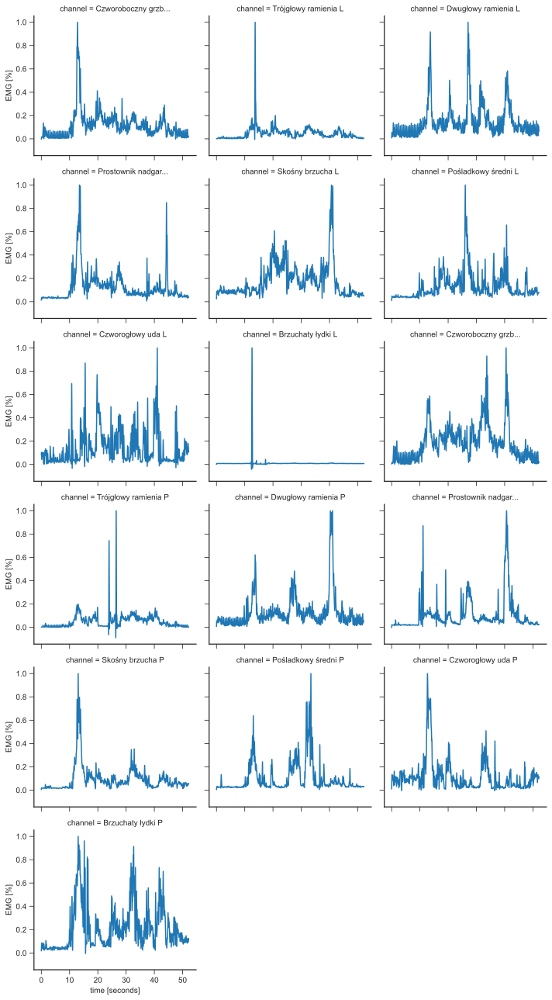

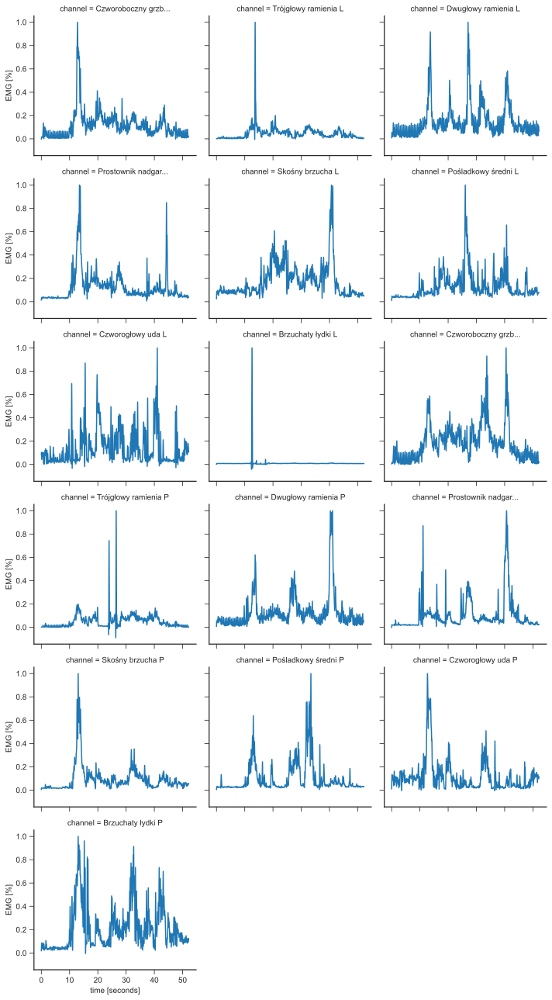

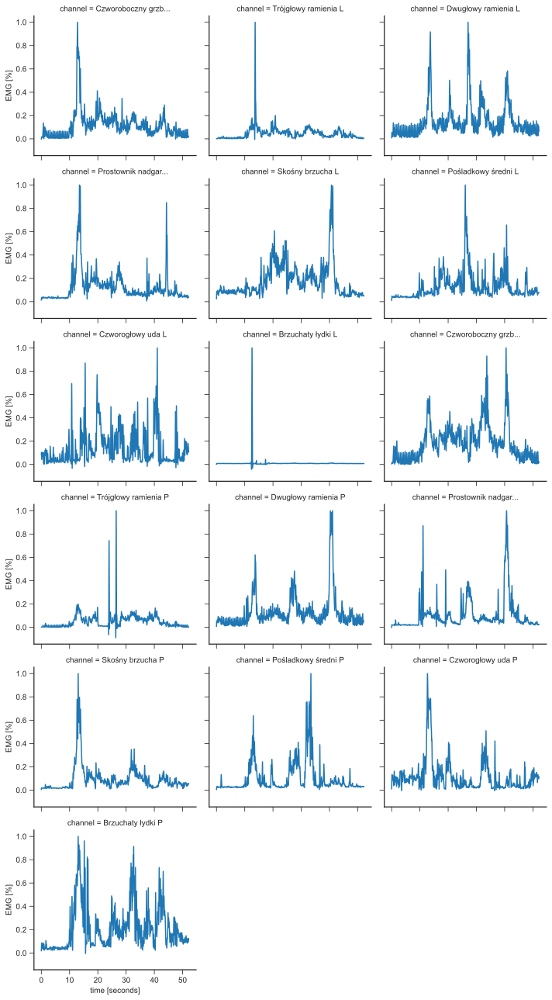

In [200]:
emg_processed = normalize_data(readed_emg)
emg_processed2 = normalize_data(readed_emg2)
emg_processed3 = normalize_data(readed_emg3)
show_emg_data(emg_processed)
show_emg_data(emg_processed2)
show_emg_data(emg_processed3)

## Odczytanie czasu event'ów:

In [180]:
event_time = read_events(data_path)
event_time

array([10.90999985, 12.25      , 12.26000023, 15.07999992, 16.18000031,
       19.12999916, 19.30999947, 24.03000069, 24.88999939, 30.46999931,
       31.13999939, 35.74000168, 37.15000153, 43.52999878])

In [181]:
event_time2 = read_events(data_path2)
event_time2

array([ 9.18999958, 11.18999958, 11.19999981, 15.15999985, 18.86000061,
       20.36000061, 21.42000008, 24.14999962, 39.22000122, 42.49000168,
       51.83000183, 55.97000122,  2.41000009,  6.38000011])

## Event'y nałożone na przebieg pracy mięśni:

In [186]:
def data_with_events(data_path):
    aver_arr=np.zeros((16,1000))
    
    for num in range(16):
            subplot(1, 2, 1)
            plt.subplots_adjust(left=0.125,
                        bottom=0.1, 
                        right=5, 
                        top=0.3, 
                        wspace=0.25, 
                        hspace=0.35)
        
            emg_processed_event=emg_processed[num]
            emg_processed_event2 = (
            emg_processed_event.meca.normalize(ref=None, scale=1)            
            )
            time_normalized=emg_processed_event2.meca.time_normalize(n_frames=1000)
        
            c3d_to_compare= c3d(data_path)
            event_time = c3d_to_compare['parameters']['EVENT']['TIMES']['value'][1]
            n_frames = c3d_to_compare['parameters']['POINT']['FRAMES']['value'][0]
            nn = n_frames/1000
            markevent = event_time/nn*100
       
            for t in range(1000):
                    aver_arr[num][t]=aver_arr[num][t]+time_normalized.values[t]
       
            aver_arr[num]=aver_arr[num]/10
            time=np.linspace(1,1000,1000)
            plt.plot(time,aver_arr[num]) 
            axl = 0
            for axl in range(14):
                plt.axvline(markevent[axl], color='r')
            plt.title(muscles_names[num])
            plt.fill_between(time,aver_arr[num])
            plt.show()

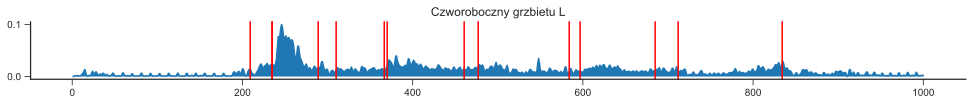

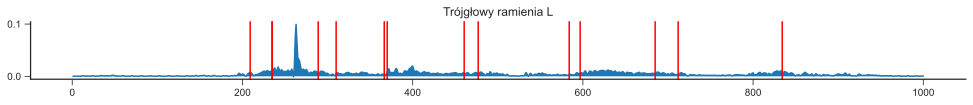

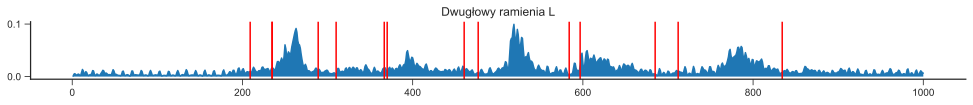

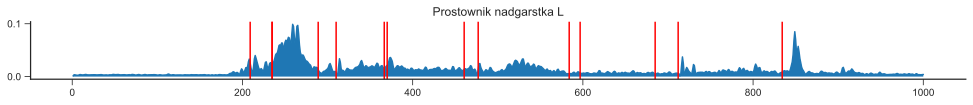

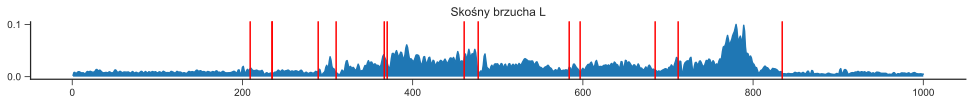

...

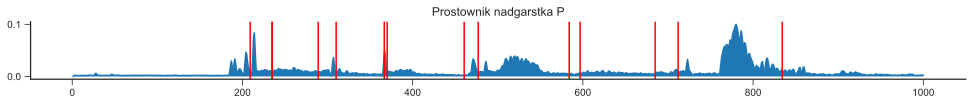

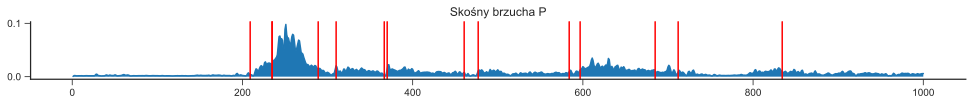

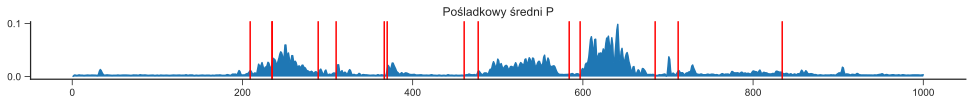

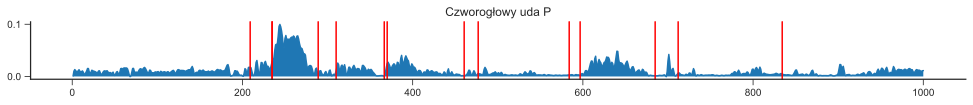

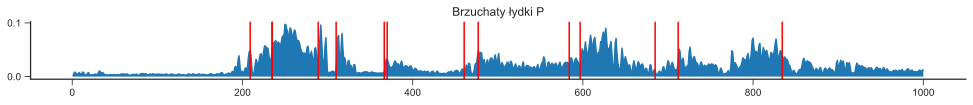

In [187]:
data_with_events(data_path)

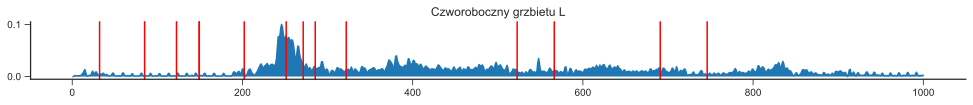

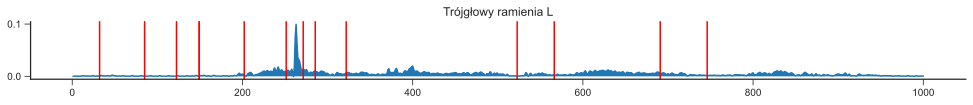

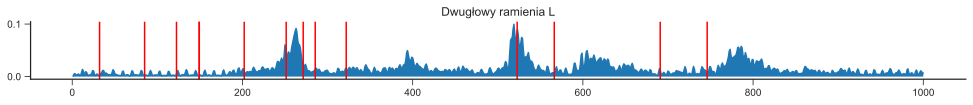

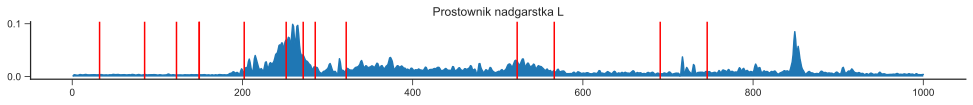

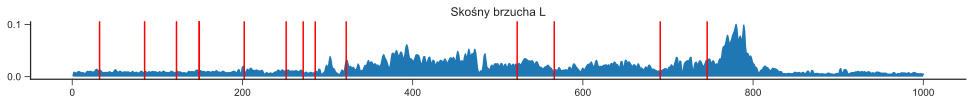

...

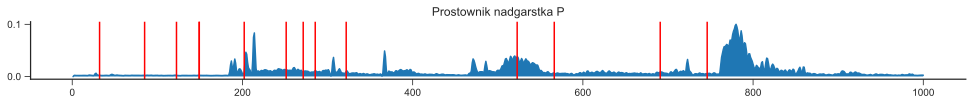

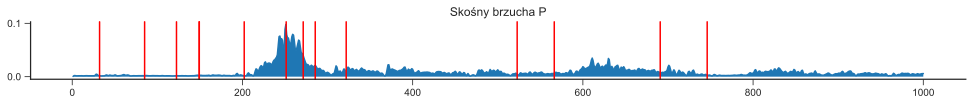

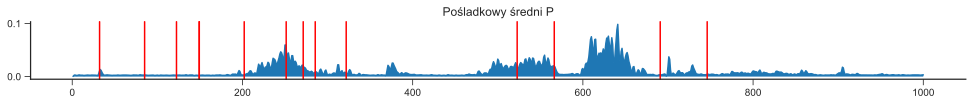

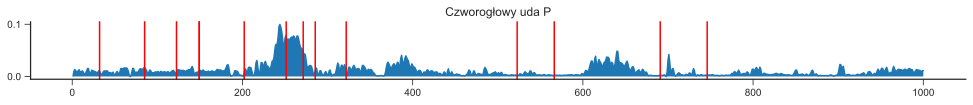

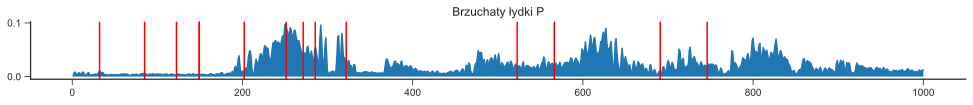

In [188]:
data_with_events(data_path2)

#### Wyświetlanie wybranych event'ów

In [89]:
def plot_one_event(event_time_start, event_time_end):
    aver_arr=np.zeros((16,1000))
    
    for num in range(16):
            subplot(1, 2, 1)
            plt.subplots_adjust(left=0.125,
                        bottom=0.1, 
                        right=5, 
                        top=0.3, 
                        wspace=0.25, 
                        hspace=0.35)
        
            emg_processed_event=emg_processed[num]
            emg_processed_event2 = (
            emg_processed_event.meca.normalize(ref=None, scale=1)            
            )
            time_normalized=emg_processed_event2.meca.time_normalize(n_frames=1000)
        
            c3d_to_compare= c3d(data_path)
            event_time = c3d_to_compare['parameters']['EVENT']['TIMES']['value'][1]
            n_frames = c3d_to_compare['parameters']['POINT']['FRAMES']['value'][0]
            nn = n_frames/1000
            markevent_start = event_time_start/nn*100
            markevent_end = event_time_end/nn*100
       
            for t in range(1000):
                    aver_arr[num][t]=aver_arr[num][t]+time_normalized.values[t]
            
            x_axes_start = markevent_start - 5
            x_axes_end = markevent_end + 5
       
            aver_arr[num]=aver_arr[num]/10
            time_aver=np.linspace(x_axes_start,x_axes_end,1000)
            plt.plot(time_aver,aver_arr[num]) 
            plt.axvline(markevent_start, color='g')
            plt.axvline(markevent_end, color='r')
            plt.title(muscles_names[num])
            #plt.fill_between(time,aver_arr[num])
            plt.show()

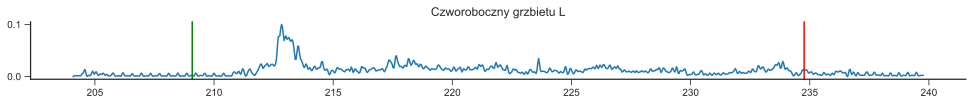

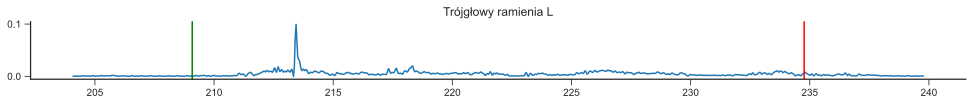

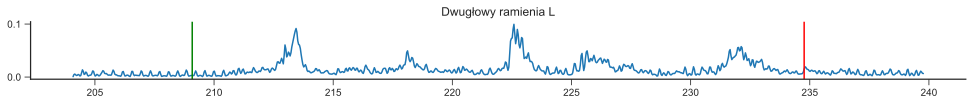

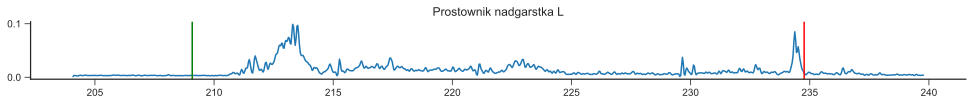

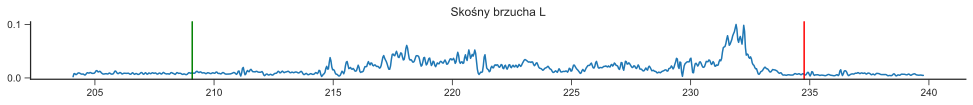

...

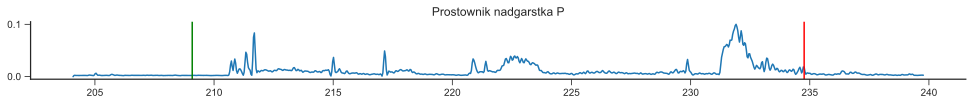

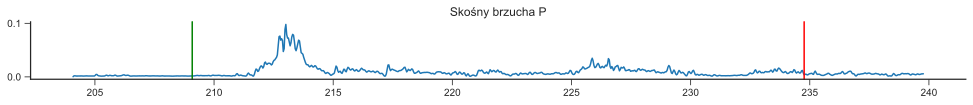

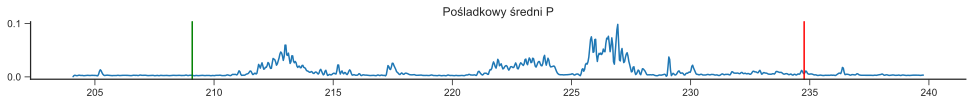

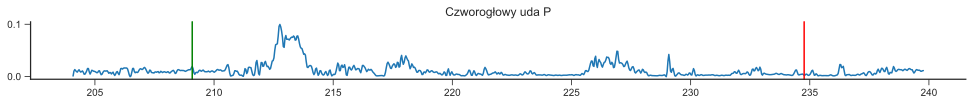

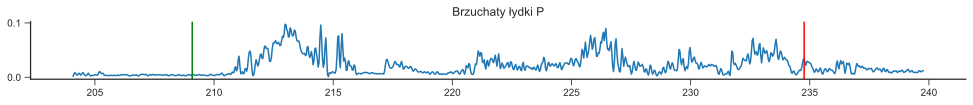

In [157]:
plot_one_event(event_time[0], event_time[1])

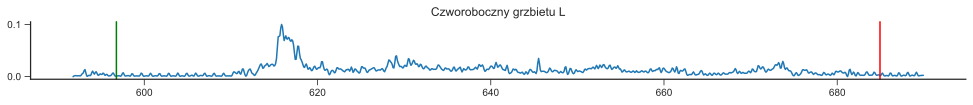

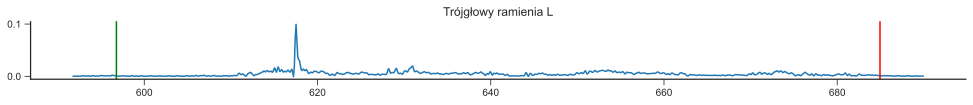

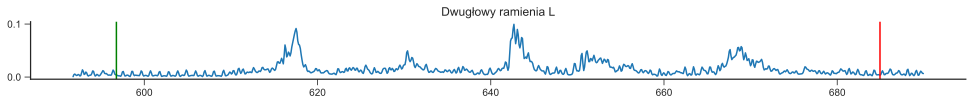

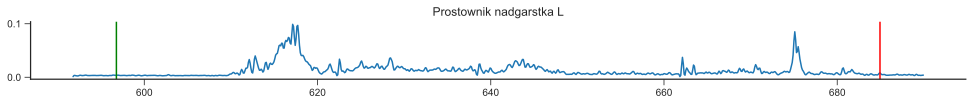

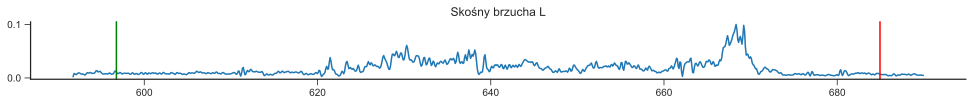

...

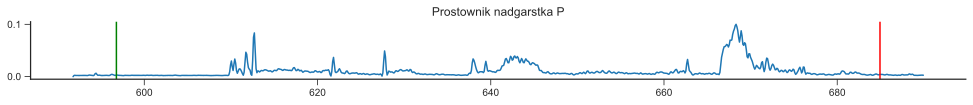

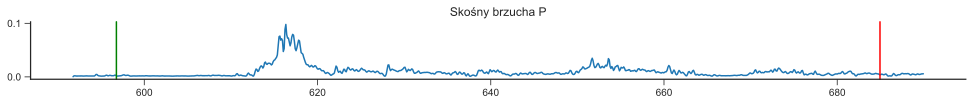

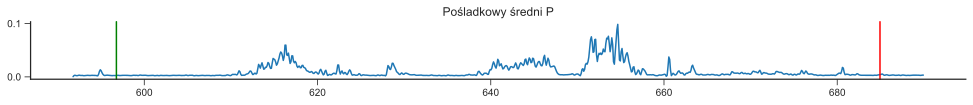

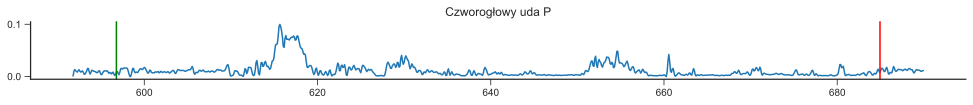

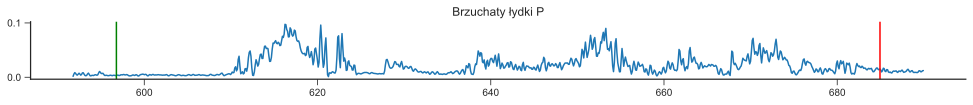

In [182]:
plot_one_event(event_time[10], event_time[11])

In [205]:
import glob

def compare_events_average(path):
         
    aver_arr_all=np.zeros((16,1000))     
    
    for file in glob.glob(path,recursive = True):
        print(file)
        emg_processed=normalize_data(file)

        aver_arr=np.zeros((16,1000))  
        file_num=0

        for num in range(16):

            emg_processed_event=emg_processed[num]
            emg_processed_event2 = (
            emg_processed_event.meca.normalize(ref=None, scale=1)                
            )
            time_normalized=emg_processed_event2.meca.time_normalize(n_frames=1000)
                
            #c3d_to_compare= c3d(file)
            #event_time = c3d_to_compare['parameters']['EVENT']['TIMES']['value'][1]
            #n_frames = c3d_to_compare['parameters']['POINT']['FRAMES']['value'][0]
            #nn = n_frames/1000

            for t in range(1000):
                aver_arr[num][t]=aver_arr[num][t]+time_normalized.values[t]

            aver_arr[num]=aver_arr[num]/10

            for t2 in range(1000):
                aver_arr_all[file_num][t2]=aver_arr_all[file_num][t2]+time_normalized.values[t2]
            file_num=file_num+1;
        
    
    for num in range(16):
        #subplot(1, 2, 1)
        #plt.subplots_adjust(left=0.125,
        #            bottom=0.1, 
        #            right=5, 
        #            top=0.25, 
        #            wspace=0.25, 
        #            hspace=0.35)
        #time=np.linspace(1,1000,1000)
        aver_arr_all[num]=aver_arr_all[num]/5
        #plt.plot(time,aver_arr_all[num])     
        #plt.title(muscles_names[num])
        #plt.fill_between(time,aver_arr_all[num])
        #plt.show()
    return aver_arr_all

In [206]:
averr_arr1 = compare_events_average(data_path)
averr_arr2 = compare_events_average(data_path2)

../Jupyter/c3d/B0437 PrzenoszeniePrawidlowe T01.c3d
../Jupyter/c3d/B0437 PrzenoszeniePrawidlowe T02.c3d


In [207]:
averr_arr3 = compare_events_average(data_path3)

../Jupyter/c3d/B0437 PrzenoszenieNieprawidlowe T02.c3d


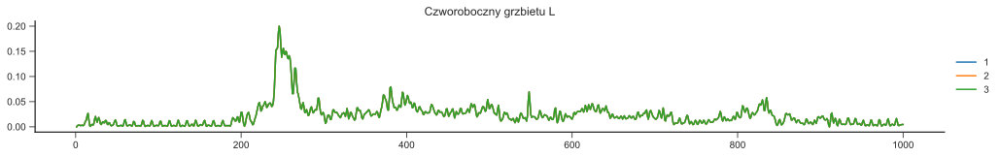

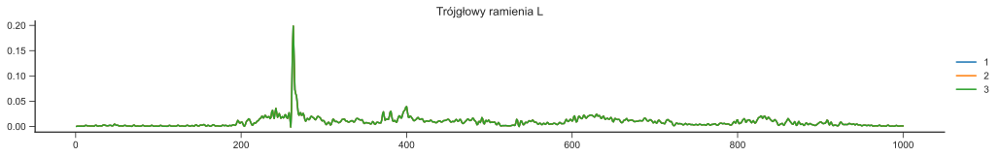

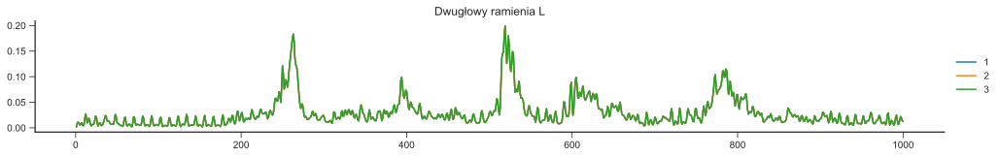

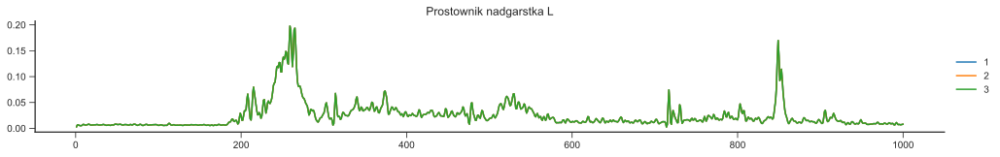

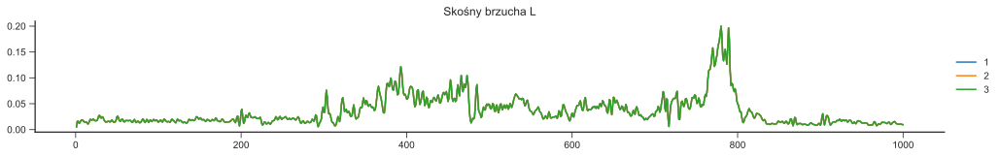

...

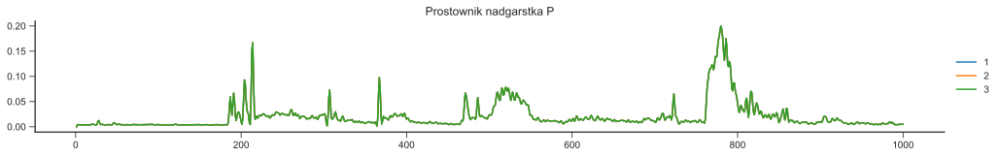

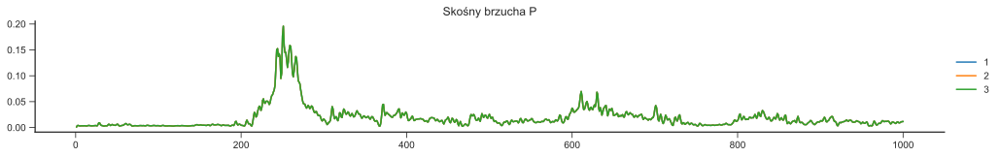

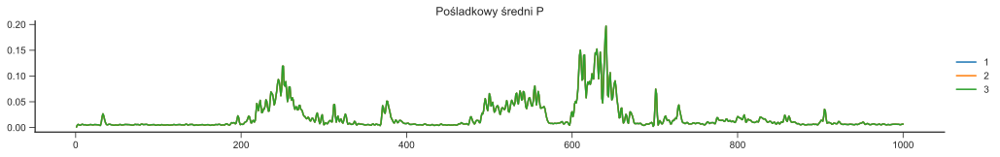

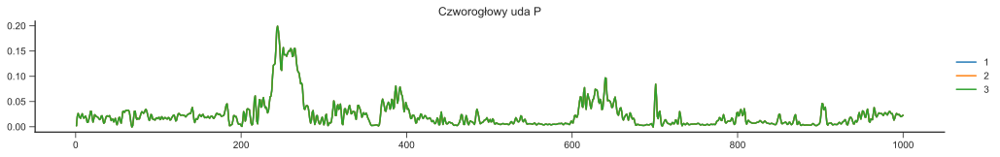

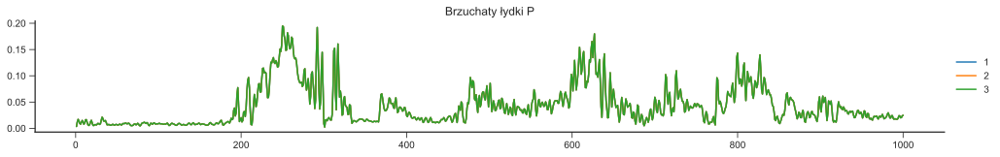

In [196]:
time=np.linspace(1,1000,1000)
aver_arr_all=np.zeros((16,1000))
for num in range(16):
    subplot(1, 2, 1)
    plt.subplots_adjust(left=0.125,
                bottom=0.1, 
                right=5, 
                top=0.5, 
                wspace=0.25, 
                hspace=0.35)
    aver_arr_all[num]=aver_arr_all[num]/2
    plt.plot(time,averr_arr1[num], label = "1")
    plt.plot(time,averr_arr2[num], label = "2")
    plt.plot(time,averr_arr3[num], label = '3')
    plt.title(muscles_names[num])
    plt.legend(loc='right', borderaxespad=-5) 
    plt.show()